# Yoonhyuck WOO / Purdue University_Computer and Information Technology
# Assignment 3: Explainable AI tools
# Professor: Dr. Pradhan

## Date: 2.26 - 5:00pm 3/4/2024 (EST)

## references
- Class Lectures
- https://christophm.github.io/interpretable-ml-book/shap.html#shap-summary-plot
- https://towardsdatascience.com/using-shap-values-to-explain-how-your-machine-learning-model-works-732b3f40e137
- https://developer.nvidia.com/blog/explain-your-machine-learning-model-predictions-with-gpu-accelerated-shap/

The goal of this assignment is to learn how to generate explanations for machine learning model predictions. We will work with the German Credit dataset that we used in the previous assignment, and consider two popular explanation mechanisms-- LIME and SHAP-- for a couple of machine learning models.

This notebook has four stages in which we will: 
1. Generate explanations for a learned logistic regression classifier using LIME.
2. Generate explanations for the same classifier using SHAP.
3. Compare the explanations generated by LIME and SHAP.
4. Explore LIME and SHAP for another classifier. 

In [4]:
!pip install shap==0.39.0
!pip install lime

In [1]:
%matplotlib inline

import sklearn
import sklearn.model_selection
import sklearn.metrics
import sklearn.datasets
import sklearn.ensemble
import sklearn.preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split, KFold, cross_val_score

from IPython.display import Markdown, display, Image
import matplotlib.pyplot as plt
import warnings

import lime
import lime.lime_tabular
from lime import submodular_pick

from IPython.core.display import HTML 
import operator
from collections import defaultdict

import json
from collections import OrderedDict

import numpy as np
import pandas as pd

np.random.seed(1)

### Dataset

As in the previous assignments, we will work with the German Credit dataset, which is one of the most popular datasets in the XAI literature. (More information about the dataset can be found here: https://archive.ics.uci.edu/dataset/144/statlog+german+credit+data).

The task for this dataset is to predict whether an individual is a good credit risk or a bad credit risk.

In [2]:
cols = ['status', 'duration', 'credit_hist', 'purpose', 'credit_amt', 'savings', 'employment',\
            'install_rate', 'personal_status', 'debtors', 'residence', 'property', 'age', 'install_plans',\
            'housing', 'num_credits', 'job', 'num_liable', 'telephone', 'foreign_worker', 'credit']
data_df = pd.read_table('D:\DOWNLOAD\statlog+german+credit+data/german.data', names=cols, sep=" ", index_col=False)
data_df['credit'] = data_df['credit'].replace(2, 0) #1 = Good, 2= Bad credit risk
y = data_df['credit']

print("Shape: ", data_df.shape)
data_df.head()

Shape:  (1000, 21)


,status,duration,credit_hist,purpose,credit_amt,savings,employment,install_rate,personal_status,debtors,...,property,age,install_plans,housing,num_credits,job,num_liable,telephone,foreign_worker,credit
0,A11,6,A34,A43,1169,A65,A75,4,A93,A101,...,A121,67,A143,A152,2,A173,1,A192,A201,1
1,A12,48,A32,A43,5951,A61,A73,2,A92,A101,...,A121,22,A143,A152,1,A173,1,A191,A201,0
2,A14,12,A34,A46,2096,A61,A74,2,A93,A101,...,A121,49,A143,A152,1,A172,2,A191,A201,1
3,A11,42,A32,A42,7882,A61,A74,2,A93,A103,...,A122,45,A143,A153,1,A173,2,A191,A201,1
4,A11,24,A33,A40,4870,A61,A73,3,A93,A101,...,A124,53,A143,A153,2,A173,2,A191,A201,0


In [3]:
# Get a list of feature names (excluding the outcome variable)
feature_names = data_df.columns[:-1]
print(feature_names)

Index(['status', 'duration', 'credit_hist', 'purpose', 'credit_amt', 'savings',
       'employment', 'install_rate', 'personal_status', 'debtors', 'residence',
       'property', 'age', 'install_plans', 'housing', 'num_credits', 'job',
       'num_liable', 'telephone', 'foreign_worker'],
      dtype='object')


### Data preprocessing

In this assignment, we will utilize sklearn's built-in encoders for data preprocessing:

In [4]:
# Label encoding
labels = data_df.iloc[:,-1]
le= sklearn.preprocessing.LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_
data = data_df.iloc[:,:-1]
le_label_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Class names: ", class_names)
print("Label mapping: ", le_label_mapping)

Class names:  [0 1]
Label mapping:  {0: 0, 1: 1}


In [5]:
# Check if there are categorical varibles that we need to make dummies for
print(data.dtypes)

# Get a list of which variables are categorical
categorical_features  = [i for i in range(len(data.dtypes)) if data.dtypes[i]=='object']
print("Indices of categorical features: ", categorical_features)

status             object
duration            int64
credit_hist        object
purpose            object
credit_amt          int64
savings            object
employment         object
install_rate        int64
personal_status    object
debtors            object
residence           int64
property           object
age                 int64
install_plans      object
housing            object
num_credits         int64
job                object
num_liable          int64
telephone          object
foreign_worker     object
dtype: object
Indices of categorical features:  [0, 2, 3, 5, 6, 8, 9, 11, 13, 14, 16, 18, 19]


Our explainers will require us to provide categorical features as a single column, not as dummies, so we cannot just explode these columns using one-hot encoding the way we normally would during pre-processing.

Instead, we will use some sklearn tools to take the following steps:
<ul>
<li>Encode the existing feature values with a number corresponding to each feature value.
<li>Make a dictionary storing the relationship between the original string feature value and the number we have replaced it with (categorical_names).
<li>Make a function that we can use later to transform categorical features into dummies.
</ul>

In [6]:
categorical_names = {}
for feature in categorical_features:
    print("Feature: ", feature)
    # Use label encoder to map categories to numbers
    le = sklearn.preprocessing.LabelEncoder()
    le.fit(data.iloc[:, feature])
    # Replace the feature values with corresponding numbers in the original data
    data.iloc[:, feature] = le.transform(data.iloc[:, feature])
    # Store and print the mappings for reference later
    categorical_names[feature] = le.classes_
    print(categorical_names[feature])
    print("==================================================")
    
# This variable stores the original names of each feature value for each feature
categorical_names

Feature:  0
['A11' 'A12' 'A13' 'A14']
Feature:  2
['A30' 'A31' 'A32' 'A33' 'A34']
Feature:  3
['A40' 'A41' 'A410' 'A42' 'A43' 'A44' 'A45' 'A46' 'A48' 'A49']
Feature:  5
['A61' 'A62' 'A63' 'A64' 'A65']
Feature:  6
['A71' 'A72' 'A73' 'A74' 'A75']
Feature:  8
['A91' 'A92' 'A93' 'A94']
Feature:  9
['A101' 'A102' 'A103']
Feature:  11
['A121' 'A122' 'A123' 'A124']
Feature:  13
['A141' 'A142' 'A143']
Feature:  14
['A151' 'A152' 'A153']
Feature:  16
['A171' 'A172' 'A173' 'A174']
Feature:  18
['A191' 'A192']
Feature:  19
['A201' 'A202']


{0: array(['A11', 'A12', 'A13', 'A14'], dtype=object),
 2: array(['A30', 'A31', 'A32', 'A33', 'A34'], dtype=object),
 3: array(['A40', 'A41', 'A410', 'A42', 'A43', 'A44', 'A45', 'A46', 'A48',
        'A49'], dtype=object),
 5: array(['A61', 'A62', 'A63', 'A64', 'A65'], dtype=object),
 6: array(['A71', 'A72', 'A73', 'A74', 'A75'], dtype=object),
 8: array(['A91', 'A92', 'A93', 'A94'], dtype=object),
 9: array(['A101', 'A102', 'A103'], dtype=object),
 11: array(['A121', 'A122', 'A123', 'A124'], dtype=object),
 13: array(['A141', 'A142', 'A143'], dtype=object),
 14: array(['A151', 'A152', 'A153'], dtype=object),
 16: array(['A171', 'A172', 'A173', 'A174'], dtype=object),
 18: array(['A191', 'A192'], dtype=object),
 19: array(['A201', 'A202'], dtype=object)}

In [7]:
print(categorical_names)

{0: array(['A11', 'A12', 'A13', 'A14'], dtype=object), 2: array(['A30', 'A31', 'A32', 'A33', 'A34'], dtype=object), 3: array(['A40', 'A41', 'A410', 'A42', 'A43', 'A44', 'A45', 'A46', 'A48',
       'A49'], dtype=object), 5: array(['A61', 'A62', 'A63', 'A64', 'A65'], dtype=object), 6: array(['A71', 'A72', 'A73', 'A74', 'A75'], dtype=object), 8: array(['A91', 'A92', 'A93', 'A94'], dtype=object), 9: array(['A101', 'A102', 'A103'], dtype=object), 11: array(['A121', 'A122', 'A123', 'A124'], dtype=object), 13: array(['A141', 'A142', 'A143'], dtype=object), 14: array(['A151', 'A152', 'A153'], dtype=object), 16: array(['A171', 'A172', 'A173', 'A174'], dtype=object), 18: array(['A191', 'A192'], dtype=object), 19: array(['A201', 'A202'], dtype=object)}


In [8]:
# We will use the encoder function to transform the categorical columns into dummies-- 
# but we cannot do that to the original dataset if we want to use LIME
encoder = ColumnTransformer(transformers=[('get_dummies', OneHotEncoder(), categorical_features)], remainder='passthrough')
encoder = encoder.fit(data)

In [9]:
print(encoder)

ColumnTransformer(remainder='passthrough',
                  transformers=[('get_dummies', OneHotEncoder(),
                                 [0, 2, 3, 5, 6, 8, 9, 11, 13, 14, 16, 18,
                                  19])])


### Split the data into training and test subsets

In [10]:
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(data, labels, train_size=0.80, random_state=10)
print("Train shape: ", train.shape)
print("Test shape: ", test.shape)

Train shape:  (800, 20)
Test shape:  (200, 20)


In [11]:
print(labels_test)

[1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0
 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1
 1 1 1 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1
 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1
 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1
 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1]


### Fit the model and make predictions

In [12]:
model = sklearn.linear_model.LogisticRegression(penalty="l2", C=0.1)
model.fit(train, labels_train)

# model predictions
pred_labels_test = model.predict((test))
print("Test set accuracy: ", sklearn.metrics.accuracy_score(labels_test, pred_labels_test))

Test set accuracy:  0.76


C:\Users\LG\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


 The prediction function `predict_fn` below, takes an instance and outputs prediction probabilities predicted by the learned model.

In [13]:
predict_fn = lambda x: model.predict_proba(x).astype(float)

## Section 1: LIME Explanations
We went over LIME (Local Interpretable Model-agnostic Explanations) in class. In this section, we will utilize the lime package to generate local and global explanations for a learned model.

### Generate the LIME explainer

LIME can be used for structured (tabular), unstructured (text) and image data. In this assignment, we will explore LIME's tabular explainers, which require a training set (as seen in the first parameter in the code below). The training data is used to create perturbed instances with which the learned model is probed.

In [14]:
lime_explainer = lime.lime_tabular.LimeTabularExplainer(train.values, 
                                                   feature_names=feature_names,
                                                   class_names=class_names,
                                                   categorical_features=categorical_features, 
                                                   categorical_names=categorical_names)

### LIME's local explanations

We will now explain a single test instance by using LIME's explainer created above. Select the test instance to explain by setting `idx_to_explain` below. You can also select the maximum number of features that you want to see in the  explanation by setting the `num_features` parameter.

In [15]:
idx_to_explain = 133 # index of the instance
print('Actual class: ', labels_test[idx_to_explain])

# Get explanation
exp = lime_explainer.explain_instance(test.values[idx_to_explain], predict_fn, num_features=5)

Actual class:  1


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


### Visualize the explanation 
Now that the explanation is ready, let's visualize it. 

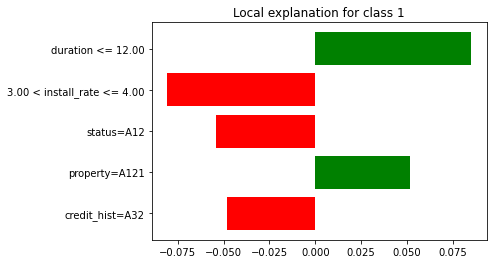

In [16]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [17]:
exp.show_in_notebook(show_all=True)

You can also see the explanations as a list:

In [18]:
exp.as_list()

[('duration <= 12.00', 0.08506919254825787),
 ('3.00 < install_rate <= 4.00', -0.08078956279573349),
 ('status=A12', -0.05430301757861372),
 ('property=A121', 0.05170631445491801),
 ('credit_hist=A32', -0.04823069815933857)]

#### Q1. Explain the LIME output above. In this example, which features have the biggest impact?

**Your analysis here:**
Duration and Install_rate have the biggest impact on each side with a similar amount, but based on the as_list result, we can find that the absolute value of Duration is bigger than Install_rate.

#### Q2. Select another test instance and explain its LIME prediction.Identify the features that have a positive and those that have a negative contribution toward the outcome.

In [19]:
idx_to_explain_q2 = 6 # index of the instance
print('Actual class: ', labels_test[idx_to_explain])

# Get explanation
exp_q2 = lime_explainer.explain_instance(test.values[idx_to_explain_q2], predict_fn, num_features=5)

Actual class:  1


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [20]:
exp_q2.show_in_notebook(show_all=False)

In [21]:
exp_q2.as_list()

[('status=A14', 0.2231457795852216),
 ('savings=A61', -0.11417673231776151),
 ('credit_hist=A34', 0.09168092736057916),
 ('3.00 < install_rate <= 4.00', -0.07932943426052134),
 ('employment=A75', 0.05854787973352191)]

**Q2_Your analysis here:**
In this instance, the Status feature shows the biggest impact on prediction. The features that positively influence prediction are Status, credit, and Employment, while Savings and Install_rate negatively influence it.

### LIME' global explanations

As we just saw, explanations can vary a lot depending on what instance we pick. While this is great for explaining a single prediction, it makes it hard to give someone an intuition for "how the model makes decisions" in general. 

That is where the **Submodular picker** comes in. It picks useful, representative examples that together give a **global explanation** for the model's behavior. (We briefly discussed submodular picker in class).

The algorithm generates global explanations using submodular picker in the following steps:
<ul>
    <li>Compute explanations for each of the examples in the dataset.</li>
    <li>The <i>coverage</i> step that we discussed in class determine which features are important in explaining a lot of the predictions i.e., features that seem <i>globally</i> important. The idea is to identify instances that cover a lot of the globally important features. </li>
    <li>The above is done by greedily selecting an example where the top globally important feature is part of the local explanation for that one example's prediction.</li>
    <li>Continue selecting examples until we have covered as many of the globally important features as possible, constrained by the number of features that the user wants returned (num_exps_desired).</li>
    </ul>

You can read the details of how this is done in the paper. More details on the function can be found here (https://lime-ml.readthedocs.io/en/latest/lime.html#lime-submodular-pick-module).

In [22]:
sp_obj = submodular_pick.SubmodularPick(lime_explainer, train.values, predict_fn, sample_size=10, 
                                        num_features=5, num_exps_desired=5)
# num_exps_desired: The number of explanation objects returned

C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid

The sp_obj object contains the `num_exps_desired` explanation objects chosen by the submodular pick algorithm. Let's take a look at it:

In [23]:
sp_obj.V

[1, 0, 4, 9, 7]

Now for each of the chosen instance, let's see if the model predicted the correct label and the explanations generated for each of the instance.

In [24]:
for ind in sp_obj.V:
    exp = lime_explainer.explain_instance(test.values[ind], predict_fn, num_features=5)
    print("Actual class: ", labels_test[ind])
    exp.show_in_notebook(show_all=False)
    print("==========================")

C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Actual class:  1


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Actual class:  1


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Actual class:  0


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Actual class:  0


C:\Users\LG\anaconda3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Actual class:  0


#### Q3. Based on these chosen examples, what can you say about how the trained model makes decisions?

**Your analysis here:**</br>
We can see how SP-LIME constructs interval values for each representative sample. For instance, the first representative sample shows the confidence interval is 85% having a reasonable credit risk, whereas 15% indicates that the instances do not. The features that influence how this instance tends to churn are Savings, Duration, Credit_hist, Install_rate, and Employment.

- Is the explanation itself reasonable?
|      | 1 | 0   |
| :---        |    :----:   |          ---: |
| **Savings**  | 1       | **4**   |
| **Credit_hist**   | **3**       | 2      |
| **Employment**  | 1       |    |
| **Duration**  | 1       | **2**   |
| **Install_rate**  |        | **3**   |
| **Property**  | **2**       |    |
| **Residence**  | **1**       |    |
| **Install_plans**  |  **1**      |    |
| **Credit_amt**  |        | **1**   |
| **Status**  | 1       | **2**   |
- Is this prediction reasonable?
|      | Actual | Prediction   |
| :---        |    :----:   |          ---: |
| **Instance 1**  | 1       | 1   |
| **Instance 2**  | 1       | 1      |
| **Instance 3**  | 0       | 1   |
| **Instance 4**  | 0       | 50/50   |
| **Instance 5**  | 0       | 1   |

SP-LIME aims to provide a brief description by choosing a small subset of features that collectively catch the model's conduct. It can induce more straightforward descriptions than analyzing a complete set of features.

# Section 2: SHAP explanations

For the same learned model, let's explain the model predictions using the SHAP implementation (https://shap.readthedocs.io/en/latest/).

### Initialize the explainer

In [25]:
import shap
shap.initjs() # INITIALIZE JAVASCRIPT

In [26]:
SHAP_explainer = shap.LinearExplainer(model, train, feature_perturbation="interventional")
shap_values = SHAP_explainer.shap_values(test)

The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


In [27]:
print(np. __version__)

1.21.4


...and apply to test data.

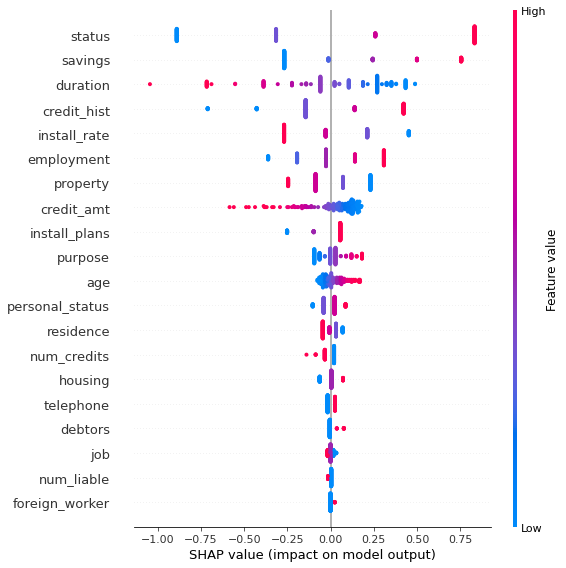

In [30]:
X_test_array = test.to_numpy() # We need to provide the data in dense format, not sparse
X_test_array = X_test_array.astype(float)
shap_values = shap_values.astype(float)
shap.summary_plot(shap_values, X_test_array, feature_names=feature_names)

The summary plot combines feature importance with feature effects. Each point on the summary plot is a Shapley value for a feature and an instance. The position on the y-axis is determined by the feature and on the x-axis by the Shapley value

#### SHAP's local explanations

For the same test data instance that you chose in Section 1 above (`idx_to_explain`), generate SHAP's explanations

In [32]:
shap.initjs()
print("Credit risk: Good" if labels_test[idx_to_explain] else "Credit risk: Bad")
print(test.iloc[idx_to_explain])
shap.force_plot(
    SHAP_explainer.expected_value, shap_values[idx_to_explain,:], X_test_array[idx_to_explain,:],
    feature_names=feature_names
)

Credit risk: Good
status               1
duration             9
credit_hist          2
purpose              4
credit_amt         790
savings              2
employment           2
install_rate         4
personal_status      1
debtors              0
residence            3
property             0
age                 66
install_plans        2
housing              1
num_credits          1
job                  1
num_liable           1
telephone            0
foreign_worker       0
Name: 723, dtype: object


#### Q4. Explain the SHAP output above. Which features have the highest contribution toward the outcome?

**Your analysis here:** </br>

##### ■ Summary plot
- The features are ordered according to their importance. Therefore, we can infer that 'Status' and 'Savings' have a higher impact on predicting whether a person will have a good credit risk or not, as compared to other features.


##### ■ Force plot
- The baseline, the average predicted probability, is 0.908, while the target value for the selected sample is 1.44. All the values greater than the base value will have a good credit risk and vice versa. For the chosen sample, the features appearing in red push the prediction toward the base value, while those in blue push the prediction away from the base value. Therefore, we can infer that having a status of 1 and install_rate of 4 negatively influences the model’s prediction for this particular person's credit risk and vice versa. 

In conclusion, based on the two plots, I think the 'Status' feature is the highest contribution because in the Summary plot, it ranked first as the most important feature, and in the Force plot, even if it has a negative impact on prediction, it is one of nearest feature based on the target value. In other words, in the force plot, the 'Status' feature negatively impacts predicting, while in the Summary plot, it is ranked first. Therefore, I infer that the highest contribution to the positive impact on prediction is 'Duration'(ranked 3rd in the Summary plot) or 'Savings' (ranked 2nd in the Summary plot) while positively impacting prediction in the Force plot.

We can also check the features that contribute to the positive and negative classes in the following manner. Check if what you obtain below is consistent with your observations in Q4.

In [33]:
# Checking features that contribute to the positive and negative classification of the instance
vals = shap_values[idx_to_explain,:]
positive_class_weight = defaultdict(float)
negative_class_weight = defaultdict(float)
feats = feature_names

for feat_i, val_i in zip(feats, vals):
  if val_i > 0:
    positive_class_weight[feat_i] += val_i
  elif val_i < 0:
    negative_class_weight[feat_i] += val_i

In [34]:
list(sorted(positive_class_weight.items(), key=operator.itemgetter(1), reverse=True))[:10]

[('duration', 0.35168051625922203),
 ('savings', 0.24338532234186402),
 ('property', 0.23036996194809675),
 ('age', 0.16977711583652785),
 ('credit_amt', 0.15519256686476102),
 ('install_plans', 0.05536735703544495),
 ('purpose', 0.02795656440594295),
 ('num_credits', 0.019708779293834827),
 ('job', 0.015670235988509914),
 ('housing', 0.004049492441918429)]

In [35]:
list(sorted(negative_class_weight.items(), key=operator.itemgetter(1)))[:10]

[('status', -0.31609505940656013),
 ('install_rate', -0.26959655491881085),
 ('credit_hist', -0.14463537610719882),
 ('personal_status', -0.04056473435492261),
 ('employment', -0.026810413636474302),
 ('telephone', -0.01745740778480294),
 ('residence', -0.00728591533735336),
 ('debtors', -0.004883075965321417),
 ('foreign_worker', -0.0009912909241218202)]

#### Q5. Select another instance and explain its prediction using SHAP. Also, identify the features that have positive and those that have negative contribution toward the outcome. 

In [37]:
shap.initjs()
print("Credit risk: Good" if labels_test[idx_to_explain_q2] else "Credit risk: Bad")
print(test.iloc[idx_to_explain_q2])
shap.force_plot(
    SHAP_explainer.expected_value, shap_values[idx_to_explain_q2,:], X_test_array[idx_to_explain_q2,:],
    feature_names=feature_names
)

Credit risk: Good
status                3
duration             24
credit_hist           4
purpose               1
credit_amt         3868
savings               0
employment            4
install_rate          4
personal_status       1
debtors               0
residence             2
property              2
age                  41
install_plans         2
housing               0
num_credits           2
job                   3
num_liable            1
telephone             1
foreign_worker        0
Name: 121, dtype: object


In [38]:
# Checking features that contribute to the positive and negative classification of the instance
vals_Q5 = shap_values[idx_to_explain,:]
positive_class_weight_Q5 = defaultdict(float)
negative_class_weight_Q5 = defaultdict(float)
feats = feature_names

for feat_i, val_i in zip(feats, vals_Q5):
  if val_i > 0:
    positive_class_weight_Q5[feat_i] += val_i
  elif val_i < 0:
    negative_class_weight_Q5[feat_i] += val_i

In [39]:
list(sorted(positive_class_weight_Q5.items(), key=operator.itemgetter(1), reverse=True))[:10]

[('duration', 0.35168051625922203),
 ('savings', 0.24338532234186402),
 ('property', 0.23036996194809675),
 ('age', 0.16977711583652785),
 ('credit_amt', 0.15519256686476102),
 ('install_plans', 0.05536735703544495),
 ('purpose', 0.02795656440594295),
 ('num_credits', 0.019708779293834827),
 ('job', 0.015670235988509914),
 ('housing', 0.004049492441918429)]

In [40]:
list(sorted(negative_class_weight_Q5.items(), key=operator.itemgetter(1)))[:10]

[('status', -0.31609505940656013),
 ('install_rate', -0.26959655491881085),
 ('credit_hist', -0.14463537610719882),
 ('personal_status', -0.04056473435492261),
 ('employment', -0.026810413636474302),
 ('telephone', -0.01745740778480294),
 ('residence', -0.00728591533735336),
 ('debtors', -0.004883075965321417),
 ('foreign_worker', -0.0009912909241218202)]

**Q5_Your analysis here:**
In this instance, the SHAP predicts that the Duration feature has the biggest positive impact on prediction, and the Status feature has the biggest negative impact.

#### SHAP's Global explanations

We can use SHAP to identify features that the model deems important on the entire data by using the `shap.plots.bar()` function.



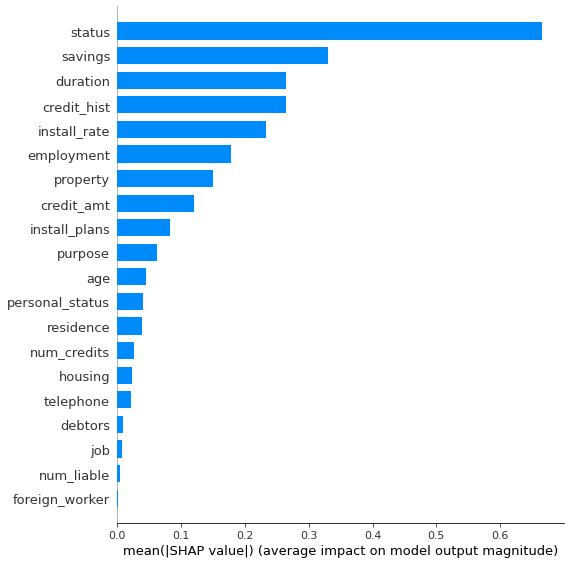

In [41]:
shap.summary_plot(shap_values, X_test_array, plot_type="bar", feature_names=feature_names)

#### Q6. Based on the above plot, what can you say about how the trained model makes decisions?

**Your analysis here:** </br>
SHAP feature importance measured as the mean absolute Shapley values, From top to bottom, it is ordered by imporatn things. Therefore, the Status was the most important feature, changing the predicted absolute credit risk probability on average by 0.6 percentage points.



# Section 3: Comparing SHAP and LIME's explanations
In this section, you will compare the explanations generated by SHAP and LIME and comment on their agreement, ease of understanding and stability over different instances.

#### Q7. For the same instance (say, `idx_to_explain` above), how do the local explanations generated by SHAP compare to that of LIME?

**Your analysis here:** </br>
SHAP is based on cooperative game theory, especially Shapley values that add to the difference between the expected model output and the actual output for a given input. Therefore, SHAP values provide an accurate and local interpretation of the model's prediction for a given input. In other words, We can see the LIME as a list of explanations that reflects the contribution of each feature to the prediction of a data sample. However, they may not directly correspond to the feature's importance or influence on the prediction as in SHAP.

#### Q8. Select another instance and compare the local explanations of LIME and SHAP. Do the explanations agree? Did you come across examples where the explanations did not agree with each other. In general, what can you comment about the stability of the explanations generated by the two methods?

**Your analysis here:** </br>
I select sixth instance. Both models predict pretty well by selecting the features that positively and negatively impact prediction, so I agree with both explanations.

For the stability of explanations, we need to consider how well it ordered the feature importance because it can impact prediction; also, based on the feature importance, we need to scrutinize the model stability, which means whether the model is sensitive to small changes.

#### Q9. How do the global explanations of SHAP compare with LIME's global explanations?

**Your analysis here:** </br>
For global explanations, the absolute Shapley values of all instances in the data are averaged. In other words, SHAP can quantify individual features' contribution to the model's output and analyze the importance of individual features in the context of the entire model.

SP-LIME focuses on selecting a subset of features that reaches the model's performance. It can achieve to identify the most critical features for the description while controlling the small subset.

# Section 4: Generating explanations for a non-linear classifier

So far in this assignment, you have worked with logistic regression which is a linear classifier. In this section, we will explore SHAP and LIME for a non-linear model such as XGBoost, random forest classifiers or neural networks.  

In [53]:
from sklearn.ensemble import RandomForestClassifier

In [54]:
rf_model = RandomForestClassifier(n_estimators = 100, max_depth = 76, max_features =  'log2', min_samples_split = 3)
    
# Fit the model using the training data
rf_model = rf_model.fit(train, labels_train, sample_weight=None)


# model predictions
rf_pred_labels_test = rf_model.predict((test))
print("Test set accuracy: ", sklearn.metrics.accuracy_score(labels_test, rf_pred_labels_test))

Test set accuracy:  0.79


# Lime Randomforest

In [55]:
predict_fn_rf = lambda x: rf_model.predict_proba(x).astype(float)
rf_exp = lime_explainer.explain_instance(test.values[idx_to_explain], predict_fn_rf, num_features=5)

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


In [56]:
rf_exp.show_in_notebook(show_all=False)
rf_exp.as_list()

[('duration <= 12.00', 0.08783129234473123),
 ('install_plans=A143', 0.07450470781229451),
 ('status=A12', -0.05031086255227853),
 ('3.00 < install_rate <= 4.00', -0.033165649511615825),
 ('property=A121', 0.030774651192787713)]

In [79]:
sp_obj_rf = submodular_pick.SubmodularPick(lime_explainer, train.values, predict_fn_rf, sample_size=10, 
                                        num_features=5, num_exps_desired=5)
# num_exps_desired: The number of explanation objects returned

X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


In [80]:
sp_obj_rf.V

[2, 7, 9, 1, 0]

In [81]:
for ind in sp_obj_rf.V:
    exp = lime_explainer.explain_instance(test.values[ind], predict_fn, num_features=5)
    print("Actual class: ", labels_test[ind])
    exp.show_in_notebook(show_all=False)
    print("==========================")

X does not have valid feature names, but LogisticRegression was fitted with feature names


Actual class:  1


X does not have valid feature names, but LogisticRegression was fitted with feature names


Actual class:  0


X does not have valid feature names, but LogisticRegression was fitted with feature names


Actual class:  0


X does not have valid feature names, but LogisticRegression was fitted with feature names


Actual class:  1


X does not have valid feature names, but LogisticRegression was fitted with feature names


Actual class:  1


# SHAP RandomForest

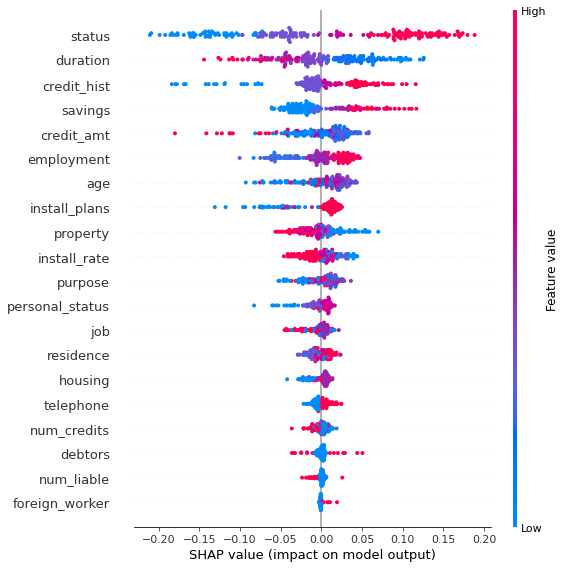

In [68]:
SHAP_explainer_rf = shap.TreeExplainer(rf_model)
shap_values_rf = SHAP_explainer_rf.shap_values(test)
X_test_array = test.to_numpy() # We need to provide the data in dense format, not sparse
shap.summary_plot(shap_values_rf[1], X_test_array, feature_names=feature_names)

In [69]:
shap.initjs()
print("Credit risk: Good" if labels_test[idx_to_explain] else "Credit risk: Bad")
print(test.iloc[idx_to_explain])
# shap.force_plot(
#     SHAP_explainer_rf.expected_value, shap_values_rf[0], X_test_array[0],
#     feature_names=feature_names)
# shap.force_plot(
#     SHAP_explainer_rf.expected_value[1], shap_values_rf[1], idx_to_explain_q2)
choosen_instance = test.iloc[idx_to_explain]
shap_values_rf = SHAP_explainer_rf.shap_values(choosen_instance)
shap.initjs()
shap.force_plot(SHAP_explainer_rf.expected_value[1], shap_values_rf[1], choosen_instance)

Credit risk: Good
status               1
duration             9
credit_hist          2
purpose              4
credit_amt         790
savings              2
employment           2
install_rate         4
personal_status      1
debtors              0
residence            3
property             0
age                 66
install_plans        2
housing              1
num_credits          1
job                  1
num_liable           1
telephone            0
foreign_worker       0
Name: 723, dtype: object


In [72]:
# Checking features that contribute to the positive and negative classification of the instance
vals_Q10 = shap_values_rf[1]
positive_class_weight_Q10 = defaultdict(float)
negative_class_weight_Q10 = defaultdict(float)
feats = feature_names

for feat_i, val_i in zip(feats, vals_Q10):
  if val_i > 0:
    positive_class_weight_Q10[feat_i] += val_i
  elif val_i < 0:
    negative_class_weight_Q10[feat_i] += val_i

In [73]:
list(sorted(positive_class_weight_Q10.items(), key=operator.itemgetter(1), reverse=True))[:10]

[('duration', 0.08593210498562595),
 ('property', 0.038197171846034994),
 ('install_plans', 0.00991348002654852),
 ('personal_status', 0.006755801686573415),
 ('purpose', 0.0035883605592522388),
 ('housing', 0.0028417300909039573),
 ('num_liable', 0.002667992000532225)]

In [74]:
list(sorted(negative_class_weight_Q10.items(), key=operator.itemgetter(1), reverse=True))[:10]

[('foreign_worker', -0.0008803659916841538),
 ('debtors', -0.003424175859511203),
 ('num_credits', -0.0067365721690863965),
 ('residence', -0.009422437761739861),
 ('job', -0.009981967774010645),
 ('telephone', -0.010624015660550032),
 ('employment', -0.010639500207880334),
 ('savings', -0.011129063243018978),
 ('credit_hist', -0.0178579727970423),
 ('install_rate', -0.036548735501629535)]

#### Q10. Select a test instance to explain and compare the local explanations over its model predictions using SHAP and LIME. 

**Your analysis here:** </br>
I keep using the first instance (133) that above. Both models selected the features that have a positive impact on prediction and a negative impact on it. However, while the LIME predicts well based on the actual, the SHAP shows a low value based on the base value. In other words, it indicates that explained features in the instance can affect the model's prediction compared to the average prediction.

#### Q11. Compare the global explanations for this model as generated by SHAP and LIME. 

**Your analysis here:**</br>
Overall, both models show many similarities with the LR case.

#### Q12. Provide a discussion of how well the two methods (SHAP and LIME) generalize to different models.

**Your analysis here:**</br>

SHAP is suitable for linear and nonlinear models because it provides explanations based on additive contributions of individual features to the model's prediction, and it captures the effects of individual features on predictions regardless of the underlying model's complexity. Shapley values provide a unified framework for explaining the importance of features across different models.

LIME can also generalize well to linear models because it can fit local interpretable models to reach the conduct of the underlying linear model near the explained instance. It is also functional to nonlinear models, but its effectiveness may vary depending on the underlying model's complexity and the explained instance's locality. In highly nonlinear regions of the feature space, LIME's local approximation needs help to grab the complicated relationships between features and predictions.

# Submitting this Assignment Notebook

Once complete, please submit your assignment notebook as an attachment under \"Assignments > Assignment 3\" on Brightspace. You can download a copy of your notebook using ```File > Download .ipynb```. Please ensure you submit the `.ipynb` file (and not a `.py` file)."